In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
df = pd.read_csv('df_acidentes_sp_moto.csv')
df.drop(columns=['Unnamed: 0'],inplace=True)
pd.set_option('max_columns', None)

df.shape

(58740, 20)

In [4]:
df.columns

Index(['Data do Acidente', 'Dia da Semana', 'Hora do Acidente', 'Turno',
       'Município', 'Jurisdição', 'Administração', 'Conservação', 'Latitude',
       'Longitude', 'Condições Climáticas', 'Iluminação', 'Mão de direção',
       'Relevo', 'Superfície da via', 'Tipo de pavimento', 'Tipo de pista',
       'Traçado', 'Tipo de Via', 'Acidente Fatal'],
      dtype='object')

In [5]:
df.isnull().sum()

Data do Acidente            0
Dia da Semana               0
Hora do Acidente          167
Turno                     167
Município                   0
Jurisdição                 92
Administração             542
Conservação               543
Latitude                    0
Longitude                   0
Condições Climáticas    10521
Iluminação              11502
Mão de direção          12288
Relevo                  12287
Superfície da via       11562
Tipo de pavimento       12287
Tipo de pista           10280
Traçado                 12287
Tipo de Via                14
Acidente Fatal              0
dtype: int64

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58740 entries, 0 to 58739
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Data do Acidente      58740 non-null  object
 1   Dia da Semana         58740 non-null  object
 2   Hora do Acidente      58573 non-null  object
 3   Turno                 58573 non-null  object
 4   Município             58740 non-null  object
 5   Jurisdição            58648 non-null  object
 6   Administração         58198 non-null  object
 7   Conservação           58197 non-null  object
 8   Latitude              58740 non-null  object
 9   Longitude             58740 non-null  object
 10  Condições Climáticas  48219 non-null  object
 11  Iluminação            47238 non-null  object
 12  Mão de direção        46452 non-null  object
 13  Relevo                46453 non-null  object
 14  Superfície da via     47178 non-null  object
 15  Tipo de pavimento     46453 non-null

## Modelando Variáveis Ciclicas;

-Data do Acidente
-Dia da Semana
 -Hora do Acidente

In [7]:
df['Data do Acidente'].sample(10)

11494    2020-09-11
1518     2021-02-06
20184    2020-05-08
29840    2019-12-07
51385    2019-02-22
24370    2020-02-26
15329    2020-07-23
21429    2020-04-13
54051    2019-01-12
49902    2019-03-18
Name: Data do Acidente, dtype: object

In [8]:
pd.set_option('max_columns', None)

In [9]:
df[['Ano','Mes','Dia']] = df['Data do Acidente'].str.split('-',expand=True)
df.sample(5)

,Data do Acidente,Dia da Semana,Hora do Acidente,Turno,Município,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal,Ano,Mes,Dia
34548,2019-10-09,QUARTA,23:02,NOITE,BARUERI,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5056429304","-46,8463585494",BOM,NOITE (VIA ILUMINADA),ÚNICA,PLANO,OLEOSA,ASFALTO,MULTIPLA,CURVA,Vias Municipais,0,2019,10,09
47883,2019-04-14,DOMINGO,20:46,NOITE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5352609166","-46,6470802404",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,SIMPLES,CRUZAMENTO,Vias Municipais,0,2019,04,14
39900,2019-08-01,QUINTA,13:02,TARDE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5180694","-46,6523974",BOM,LUZ SOLAR,ÚNICA,PLANO,SECA,ASFALTO,MULTIPLA,RETA,Vias Municipais,0,2019,08,01
14537,2020-08-02,DOMINGO,08:08,MANHA,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,4751306868072","-46,5932037046753",BOM,LUZ SOLAR,DUPLA,INCLINADO,SECA,ASFALTO,SIMPLES,CURVA,Vias Municipais,0,2020,08,02
25753,2020-02-07,SEXTA,12:18,TARDE,GUARULHOS,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,4437808311845","-46,5487788784963",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,2020,02,07


#### - Reorganizando Dataset

In [10]:
df.columns

Index(['Data do Acidente', 'Dia da Semana', 'Hora do Acidente', 'Turno',
       'Município', 'Jurisdição', 'Administração', 'Conservação', 'Latitude',
       'Longitude', 'Condições Climáticas', 'Iluminação', 'Mão de direção',
       'Relevo', 'Superfície da via', 'Tipo de pavimento', 'Tipo de pista',
       'Traçado', 'Tipo de Via', 'Acidente Fatal', 'Ano', 'Mes', 'Dia'],
      dtype='object')

In [11]:
df = df[['Data do Acidente','Dia','Mes','Ano','Dia da Semana', 'Hora do Acidente', 'Turno',
       'Município', 'Jurisdição', 'Administração', 'Conservação', 'Latitude',
       'Longitude', 'Condições Climáticas', 'Iluminação', 'Mão de direção',
       'Relevo', 'Superfície da via', 'Tipo de pavimento', 'Tipo de pista',
       'Traçado', 'Tipo de Via', 'Acidente Fatal']]

In [12]:
df.shape # ou seja apenas adicionamos o dia e mes!

(58740, 23)

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58740 entries, 0 to 58739
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Data do Acidente      58740 non-null  object
 1   Dia                   58740 non-null  object
 2   Mes                   58740 non-null  object
 3   Ano                   58740 non-null  object
 4   Dia da Semana         58740 non-null  object
 5   Hora do Acidente      58573 non-null  object
 6   Turno                 58573 non-null  object
 7   Município             58740 non-null  object
 8   Jurisdição            58648 non-null  object
 9   Administração         58198 non-null  object
 10  Conservação           58197 non-null  object
 11  Latitude              58740 non-null  object
 12  Longitude             58740 non-null  object
 13  Condições Climáticas  48219 non-null  object
 14  Iluminação            47238 non-null  object
 15  Mão de direção        46452 non-null

In [14]:
df[['Mes', 'Dia']] = df[['Mes', 'Dia']].astype('int64')

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58740 entries, 0 to 58739
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Data do Acidente      58740 non-null  object
 1   Dia                   58740 non-null  int64 
 2   Mes                   58740 non-null  int64 
 3   Ano                   58740 non-null  object
 4   Dia da Semana         58740 non-null  object
 5   Hora do Acidente      58573 non-null  object
 6   Turno                 58573 non-null  object
 7   Município             58740 non-null  object
 8   Jurisdição            58648 non-null  object
 9   Administração         58198 non-null  object
 10  Conservação           58197 non-null  object
 11  Latitude              58740 non-null  object
 12  Longitude             58740 non-null  object
 13  Condições Climáticas  48219 non-null  object
 14  Iluminação            47238 non-null  object
 15  Mão de direção        46452 non-null

#### - Modelando - mes

In [16]:
df['Mes'].sample(5)

57157    10
7993     10
54861     9
13983     8
18750     6
Name: Mes, dtype: int64

In [17]:
df['Mes'].describe() # Tudo certo com o mes !

count    58740.000000
mean         6.368607
std          3.545260
min          1.000000
25%          3.000000
50%          6.000000
75%          9.000000
max         12.000000
Name: Mes, dtype: float64

In [18]:
df['Mes_sin']=np.sin(2.*np.pi*df['Mes']/12)
df['Mes_cos']=np.cos(2.*np.pi*df['Mes']/12)

In [19]:
df.sample(5)

,Data do Acidente,Dia,Mes,Ano,Dia da Semana,Hora do Acidente,Turno,Município,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal,Mes_sin,Mes_cos
43078,2019-06-16,16,6,2019,DOMINGO,19:15,NOITE,MOGI DAS CRUZES,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5224470619","-46,1991378054",BOM,NOITE (VIA ILUMINADA),DUPLA,PLANO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,1.224647e-16,-1.000000
25732,2020-02-07,7,2,2020,SEXTA,07:37,MANHA,OSASCO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5228199604313","-46,7923585634618",BOM,LUZ SOLAR,DUPLA,PLANO,OUTRAS,ASFALTO,SIMPLES,RETA,Vias Municipais,0,8.660254e-01,0.500000
30732,2019-11-26,26,11,2019,TERÇA,16:42,TARDE,SAO BERNARDO DO CAMPO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,728383002","-46,577387674",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,-5.000000e-01,0.866025
29900,2019-12-06,6,12,2019,SEXTA,08:11,MANHA,SAO BERNARDO DO CAMPO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6659694063","-46,5727684275",NEVOEIRO/NEBLINA,LUZ SOLAR,ÚNICA,PLANO,OUTRAS,ASFALTO,MULTIPLA,RETA,Vias Municipais,0,-2.449294e-16,1.000000
53968,2019-01-14,14,1,2019,SEGUNDA,12:15,TARDE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,67875656590892","-46,69634540556645",BOM,LUZ SOLAR,ÚNICA,PLANO,SECA,ASFALTO,MULTIPLA,RETA,Rodovias,0,5.000000e-01,0.866025


C:\Users\Renato\anaconda3\envs\Data_Science\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Mes_sin', ylabel='Mes_cos'>

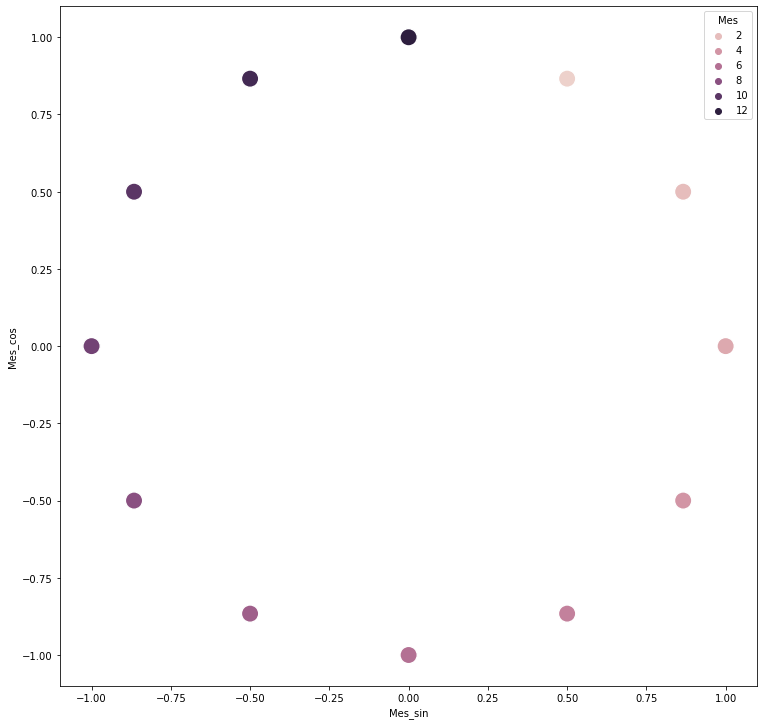

In [20]:
plt.figure(figsize=(12.5,12.5))
sns.scatterplot(df['Mes_sin'],df['Mes_cos'],hue=df['Mes'],s=300)

#### - Modelando - dia_semana

In [21]:
df['Dia da Semana'].value_counts()

SEXTA      10033
SÁBADO      8777
QUINTA      8567
QUARTA      8417
SEGUNDA     7964
TERÇA       7943
DOMINGO     7039
Name: Dia da Semana, dtype: int64

'''Primeiro é necessário transformar o dia da semana em número! O Label Encoder não vai funcionar, pois da ordem aleatória de números,
neste caso precisamos que segunda (1) e depois terça(2), para que os seno e cosseno realmente passem uma ideia ciclica respeitando a 
ordem dos dias da semana'''

In [22]:
# Transformando dia da semana em número e normalizando ela. Como saída teremos 3 colunas novas.

def week_to_feature(df,week_days):
    
    df['dias_semana_num']=df[week_days]
    
    dic = {'DOMINGO':7          
    ,'SÁBADO':6           
    ,'SEXTA':5   
    ,'QUINTA':4    
    ,'QUARTA':3     
    ,'TERÇA':2
    ,'SEGUNDA':1} # Começar com 1 pois caso não seja ira gerar um ciclo com 6 números
        
    for days, num in dic.items():
        
         #print (days)
         #print (num)
         df['dias_semana_num'].replace(days,num,inplace=True)
            
    df['dias_semana_norm']=df['dias_semana_num']/df['dias_semana_num'].max() # normaliza os dias da semana < 1
    
    df['dias_semana_sin']=np.sin(2.*np.pi*df.dias_semana_norm)
    df['dias_semana_cos']=np.cos(2.*np.pi*df.dias_semana_norm)
    
    # Printando o resultado do processo... 
    
    plt.figure(figsize=(12.5,12.5))
    sns.scatterplot(df['dias_semana_sin'],df['dias_semana_cos'],hue=df['Dia da Semana'],s=300)
   

C:\Users\Renato\anaconda3\envs\Data_Science\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


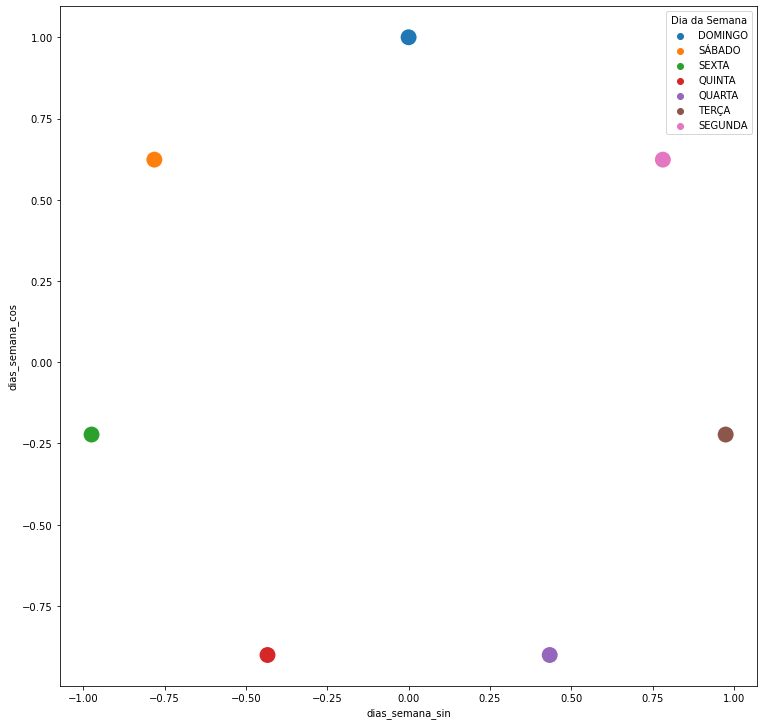

In [23]:
week_to_feature(df,'Dia da Semana')

#### - Modelando - horario

In [24]:
df['Hora do Acidente'].sample(20)

33893    13:50
54496    17:25
34811    23:50
21340    23:58
53009    14:54
29877    18:17
30361    03:28
7536     17:29
35704    10:07
27280    10:20
31908    15:29
21342    20:05
21787    16:34
6554     22:25
16526    07:40
34345    11:03
15059    19:34
7688     21:18
36518    14:57
29337    18:26
Name: Hora do Acidente, dtype: object

In [25]:
df[['Hora','Minuto','Segundo']] = df['Hora do Acidente'].str.split(':',expand=True)
df.sample(20)

,Data do Acidente,Dia,Mes,Ano,Dia da Semana,Hora do Acidente,Turno,Município,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal,Mes_sin,Mes_cos,dias_semana_num,dias_semana_norm,dias_semana_sin,dias_semana_cos,Hora,Minuto,Segundo
23545,2020-03-08,8,3,2020,DOMINGO,00:05,MADRUGADA,GUARULHOS,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,4559931125388","-46,4317494814537",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0,1.000000e+00,6.123234e-17,7,1.000000,-2.449294e-16,1.000000,00,05,None
31961,2019-11-10,10,11,2019,DOMINGO,19:48,NOITE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,683096","-46,6513841",BOM,NOITE (VIA ILUMINADA),DUPLA,PLANO,MOLHADA,ASFALTO,SIMPLES,RETA,Vias Municipais,0,-5.000000e-01,8.660254e-01,7,1.000000,-2.449294e-16,1.000000,19,48,None
4228,2020-12-22,22,12,2020,TERÇA,20:48,NOITE,MAUA,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,65134017453","-46,4411989825969",CHUVA,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,SIMPLES,RETA,Vias Municipais,0,-2.449294e-16,1.000000e+00,2,0.285714,9.749279e-01,-0.222521,20,48,None
45918,2019-05-10,10,5,2019,SEXTA,06:09,MANHA,FERRAZ DE VASCONCELOS,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5514793226","-46,3811614145",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,5.000000e-01,-8.660254e-01,5,0.714286,-9.749279e-01,-0.222521,06,09,None
53530,2019-01-21,21,1,2019,SEGUNDA,21:00,NOITE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,4922933791","-46,6319074659",BOM,NOITE (VIA ILUMINADA),DUPLA,INCLINADO,SECA,ASFALTO,DUPLA,CURVA,Vias Municipais,0,5.000000e-01,8.660254e-01,1,0.142857,7.818315e-01,0.623490,21,00,None
3155,2021-01-12,12,1,2021,TERÇA,12:11,TARDE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6547282","-46,679626",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,MULTIPLA,RETA,Vias Municipais,0,5.000000e-01,8.660254e-01,2,0.285714,9.749279e-01,-0.222521,12,11,None
52176,2019-02-10,10,2,2019,DOMINGO,18:26,NOITE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6100995378","-46,5042111293",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,DUPLA,CURVA,Vias Municipais,0,8.660254e-01,5.000000e-01,7,1.000000,-2.449294e-16,1.000000,18,26,None
23027,2020-03-14,14,3,2020,SÁBADO,13:29,TARDE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,7465260038008","-46,7074326107698",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,MULTIPLA,RETA,Vias Municipais,0,1.000000e+00,6.123234e-17,6,0.857143,-7.818315e-01,0.623490,13,29,None
21034,2020-04-21,21,4,2020,TERÇA,13:49,TARDE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,612940773274","-46,4927368447765",BOM,LUZ SOLAR,DUPLA,INCLINADO,SECA,ASFALTO,MULTIPLA,RETA,Vias Municipais,0,8.660254e-01,-5.000000e-01,2,0.285714,9.749279e-01,-0.222521,13,49,None
53897,2019-01-15,15,1,2019,TERÇA,11:21,MANHA,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,432163914","-46,7247882925",BOM,LUZ SOLAR,DUPLA,INCLINADO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,5.000000e-01,8.660254e-01,2,0.285714,9.749279e-01,-0.222521,11,21,None


In [26]:
df[['Hora','Minuto','Segundo']] = df[['Hora','Minuto','Segundo']].astype('float64')

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58740 entries, 0 to 58739
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      58740 non-null  object 
 1   Dia                   58740 non-null  int64  
 2   Mes                   58740 non-null  int64  
 3   Ano                   58740 non-null  object 
 4   Dia da Semana         58740 non-null  object 
 5   Hora do Acidente      58573 non-null  object 
 6   Turno                 58573 non-null  object 
 7   Município             58740 non-null  object 
 8   Jurisdição            58648 non-null  object 
 9   Administração         58198 non-null  object 
 10  Conservação           58197 non-null  object 
 11  Latitude              58740 non-null  object 
 12  Longitude             58740 non-null  object 
 13  Condições Climáticas  48219 non-null  object 
 14  Iluminação            47238 non-null  object 
 15  Mão de direção     

In [28]:
#preenchendo com fillna avg os acidentes que tem hora,min e seg faltando
df['Hora'].fillna(value=df['Hora'].mode()[0],inplace=True)
df['Minuto'].fillna(value=df['Minuto'].mean(),inplace=True)
df['Segundo'].fillna(value=df['Segundo'].mean(),inplace=True)


In [29]:
df['horario_float'] = df['Hora']  + df['Minuto']/60

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58740 entries, 0 to 58739
Data columns (total 33 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      58740 non-null  object 
 1   Dia                   58740 non-null  int64  
 2   Mes                   58740 non-null  int64  
 3   Ano                   58740 non-null  object 
 4   Dia da Semana         58740 non-null  object 
 5   Hora do Acidente      58573 non-null  object 
 6   Turno                 58573 non-null  object 
 7   Município             58740 non-null  object 
 8   Jurisdição            58648 non-null  object 
 9   Administração         58198 non-null  object 
 10  Conservação           58197 non-null  object 
 11  Latitude              58740 non-null  object 
 12  Longitude             58740 non-null  object 
 13  Condições Climáticas  48219 non-null  object 
 14  Iluminação            47238 non-null  object 
 15  Mão de direção     

In [31]:
df['horario_float'].sample(5)

28368    19.383333
21728     8.900000
50839    15.333333
46482    18.716667
48269    18.483333
Name: horario_float, dtype: float64

In [32]:
df['horario_sin']=np.sin(2.*np.pi*df['horario_float']/24.)
df['horario_cos']=np.cos(2.*np.pi*df['horario_float']/24.)

C:\Users\Renato\anaconda3\envs\Data_Science\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='horario_sin', ylabel='horario_cos'>

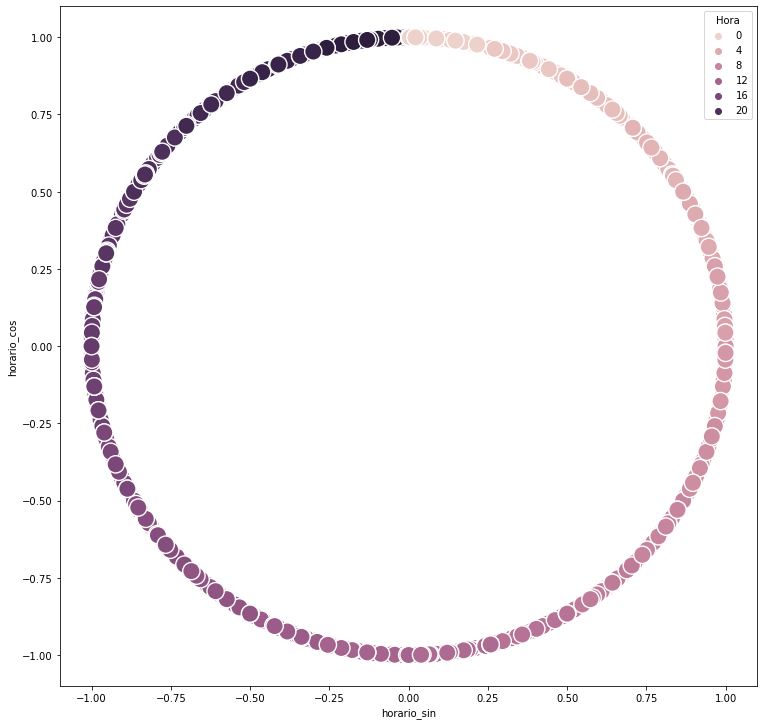

In [33]:
plt.figure(figsize=(12.5,12.5))
sns.scatterplot(df['horario_sin'],df['horario_cos'],s=300,hue=df['Hora'])

# Reorganizar Data Frame e eliminar coisas que não precisamos !!!! Depois export

In [34]:
df.shape

(58740, 35)

In [35]:
df.shape

(58740, 35)

In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58740 entries, 0 to 58739
Data columns (total 35 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      58740 non-null  object 
 1   Dia                   58740 non-null  int64  
 2   Mes                   58740 non-null  int64  
 3   Ano                   58740 non-null  object 
 4   Dia da Semana         58740 non-null  object 
 5   Hora do Acidente      58573 non-null  object 
 6   Turno                 58573 non-null  object 
 7   Município             58740 non-null  object 
 8   Jurisdição            58648 non-null  object 
 9   Administração         58198 non-null  object 
 10  Conservação           58197 non-null  object 
 11  Latitude              58740 non-null  object 
 12  Longitude             58740 non-null  object 
 13  Condições Climáticas  48219 non-null  object 
 14  Iluminação            47238 non-null  object 
 15  Mão de direção     

In [37]:
df.sample(5)

,Data do Acidente,Dia,Mes,Ano,Dia da Semana,Hora do Acidente,Turno,Município,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal,Mes_sin,Mes_cos,dias_semana_num,dias_semana_norm,dias_semana_sin,dias_semana_cos,Hora,Minuto,Segundo,horario_float,horario_sin,horario_cos
24478,2020-02-23,23,2,2020,DOMINGO,00:16,MADRUGADA,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6076706532222","-46,4472832479999",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0,8.660254e-01,5.000000e-01,7,1.000000,-2.449294e-16,1.000000,0.0,16.0,1.319248,0.266667,0.069756,0.997564
3720,2020-12-31,31,12,2020,QUINTA,18:22,NOITE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,7398100844415","-46,702651539262",BOM,NOITE (VIA ILUMINADA),ÚNICA,INCLINADO,MOLHADA,ASFALTO,DUPLA,RETA,Vias Municipais,0,-2.449294e-16,1.000000e+00,4,0.571429,-4.338837e-01,-0.900969,18.0,22.0,1.319248,18.366667,-0.995396,0.095846
21904,2020-04-03,3,4,2020,SEXTA,18:41,NOITE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6104251118817","-46,5867388749049",BOM,NOITE (VIA ILUMINADA),ÚNICA,PLANO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,8.660254e-01,-5.000000e-01,5,0.714286,-9.749279e-01,-0.222521,18.0,41.0,1.319248,18.683333,-0.984041,0.177944
42338,2019-06-27,27,6,2019,QUINTA,22:52,NOITE,SAO PAULO,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,7249668","-46,7638312",BOM,NOITE (VIA ILUMINADA),DUPLA,PLANO,SECA,ASFALTO,SIMPLES,RETA,Vias Municipais,0,1.224647e-16,-1.000000e+00,4,0.571429,-4.338837e-01,-0.900969,22.0,52.0,1.319248,22.866667,-0.292372,0.956305
36381,2019-09-16,16,9,2019,SEGUNDA,14:30,TARDE,SAO PAULO,ESTADUAL,CONCESSIONÁRIA-ARTESP,AUTOBAN,"-23,39822219267468855581","-46,76787228889320373756",BOM,LUZ SOLAR,ÚNICA,INCLINADO,SECA,ASFALTO,DUPLA,RETA,Rodovias,0,-1.000000e+00,-1.836970e-16,1,0.142857,7.818315e-01,0.623490,14.0,30.0,1.319248,14.500000,-0.608761,-0.793353


In [38]:
'''Variaveis ciclicas modeladas'''


df.to_csv('df_acidentes_sp_moto_Cyclical.csv',index=False)

In [39]:
#criando DF para exportar pro API

In [40]:
df_API_fatais = df[['Data do Acidente','Latitude','Longitude','Condições Climáticas','Hora']].loc[(df['Condições Climáticas'].isnull())&(df['Acidente Fatal']==1)]
df_API_fatais

,Data do Acidente,Latitude,Longitude,Condições Climáticas,Hora
54694,2020-12-29,"-23,7464627689999","-46,803836335",NaN,9.0
54699,2020-12-26,"-23,458778790416762","-46,48209129083817",NaN,2.0
54700,2020-12-26,"-23,418102298841816","-46,37791152937248",NaN,0.0
54701,2020-12-26,"-23,418102298841816","-46,37791152937248",NaN,0.0
54702,2020-12-26,"-23,54191853681889","-47,01329391534144",NaN,18.0
...,...,...,...,...,...
58735,2015-02-18,"-23,404111592317488","-46,57599535696205",NaN,11.0
58736,2015-01-15,"-23,632392","-46,472206",NaN,14.0
58737,2014-12-28,"-23,555237","-46,849214",NaN,14.0
58738,2014-11-05,"-23,644498","-46,538558",NaN,15.0


In [41]:
df_API_fatais.duplicated().value_counts()

False    3200
True      127
dtype: int64

In [41]:
df_API_fatais = df_API_fatais.drop_duplicates()
df_API_fatais.shape

(3200, 5)

In [42]:
df_API_fatais.to_csv(r'df_API_fatais.csv',index=False)